# Object Detection with SSD on Video

This notebook uses a [PyTorch port](https://github.com/amdegroot/ssd.pytorch) of [SSD: Single Shot MultiBox Detector](https://arxiv.org/abs/1512.02325) to detect objects on a given youtube video.

For other deep-learning Colab notebooks, visit [tugstugi/dl-colab-notebooks](https://github.com/tugstugi/dl-colab-notebooks).


## Install amdegroot/ssd.pytorch

In [ ]:
  #@title
import os
from os.path import exists, join, basename, splitext

git_repo_url = 'https://github.com/amdegroot/ssd.pytorch.git'
project_name = splitext(basename(git_repo_url))[0]
if not exists(project_name):
    # clone and install dependencies
    !git clone -q $git_repo_url
    #!cd $project_name && pip install -q -r requirement.txt
    !pip install -q youtube-dl
    !wget https://raw.githubusercontent.com/miyamotok0105/pytorch_handbook/master/chapter7/layers/functions/detection.py && mv detection.py ssd.pytorch/layers/functions
    !wget https://raw.githubusercontent.com/miyamotok0105/pytorch_handbook/master/chapter7/ssd.py && mv ssd.py ssd.pytorch/
  
import sys
sys.path.append(project_name)
import time
import matplotlib
import matplotlib.pylab as plt
plt.rcParams["axes.grid"] = False

from IPython.display import YouTubeVideo

     |████████████████████████████████| 1.9 MB 12.4 MB/s 
--2022-03-14 09:31:35--  https://raw.githubusercontent.com/miyamotok0105/pytorch_handbook/master/chapter7/layers/functions/detection.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3931 (3.8K) [text/plain]
Saving to: ‘detection.py’

detection.py        100%[===================>]   3.84K  --.-KB/s    in 0s      

2022-03-14 09:31:35 (38.1 MB/s) - ‘detection.py’ saved [3931/3931]

--2022-03-14 09:31:35--  https://raw.githubusercontent.com/miyamotok0105/pytorch_handbook/master/chapter7/ssd.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443..

## Download the SSD300 pretrained model

In [ ]:
#@title
PRETRAINED_MODEL_URL = 'https://s3.amazonaws.com/amdegroot-models/ssd300_mAP_77.43_v2.pth'
pretrained_model = basename(PRETRAINED_MODEL_URL)
if not exists(pretrained_model):
  !wget -q $PRETRAINED_MODEL_URL

## Prepare model

In [ ]:
#@title
# fix some erros
!sed -i 's/HOME = os.path.expanduser("~")/HOME = "$project_name"/' $project_name/data/config.py
!sed -i "s/COCO_ROOT = osp.join(HOME, 'data\/coco\/')/COCO_ROOT = '$project_name\/data'/" $project_name/data/coco.py
!sed -i 's/if scores.dim() == 0/if scores.size(0) == 0/' $project_name/layers/functions/detection.py

import random
import cv2
import numpy as np
import torch

from ssd import build_ssd
from data import VOC_CLASSES as labels
colors = [[random.randint(0, 255) for _ in range(3)] for _ in labels]

# build SS model
net = build_ssd('test', 300, 21)    # initialize SSD
net.load_weights(pretrained_model)
net.eval()
torch.set_grad_enabled(False)

if torch.cuda.is_available():
  net = net.cuda()
# why?
if torch.cuda.is_available():
    torch.set_default_tensor_type('torch.cuda.FloatTensor')
else:
    torch.set_default_tensor_type('torch.FloatTensor')

# test on a given image, see: https://github.com/amdegroot/ssd.pytorch/blob/master/demo/demo.ipynb
def test(rgb_image, threshold=0.6):
  # resize to 300x300
  x = cv2.resize(rgb_image, (300, 300)).astype(np.float32)
  # image net mean substract
  x -= (123.0, 117.0, 104.0)
  # image tensor
  x = torch.from_numpy(x.astype(np.float32)).permute(2, 0, 1)
  x = x.unsqueeze(0)
  if torch.cuda.is_available():
    x = x.cuda()
  
  # forward
  t = time.time()
  detections = net(x)
  #print("executed in %.3fs" % (time.time()-t))
  
  # draw boxes and labels
  result_img = np.array(rgb_image)
  scale = torch.Tensor(rgb_image.shape[1::-1]).repeat(2)
  for i in range(detections.size(1)):
    j = 0
    while detections[0,i,j,0] >= threshold:
      score = detections[0,i,j,0]
      label = labels[i-1]
      display_txt = '%s: %.2f'%(label, score)
      pt = (detections[0,i,j,1:]*scale).cpu().numpy()
      color = colors[i-1]

      # draw box
      tl = round(0.002 * max(result_img.shape[0:2])) + 1  # line thickness
      c1, c2 = (int(pt[0]), int(pt[1])), (int(pt[2]), int(pt[3]))
      cv2.rectangle(result_img, c1, c2, color, thickness=tl)

      # draw text
      tf = max(tl - 1, 1)  # font thickness
      t_size = cv2.getTextSize(display_txt, 0, fontScale=tl / 3, thickness=tf)[0]
      c2 = c1[0] + t_size[0], c1[1] - t_size[1] - 3
      cv2.rectangle(result_img, c1, c2, color, -1)  # filled
      cv2.putText(result_img, display_txt, (c1[0], c1[1] - 2), 0, tl / 3, [225, 255, 255], thickness=tf, lineType=cv2.LINE_AA)

      j+=1
      
  return result_img

Loading weights into state dict...
Finished!


## Detect objects on a test video

We are going to detect objects on the following youtube video:

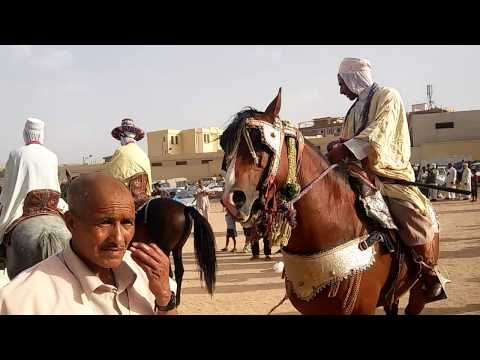

In [ ]:
YOUTUBE_ID = 'SQVpCy9Zt5c'


YouTubeVideo(YOUTUBE_ID)

First, download the above youtube video:



In [ ]:
!rm -df youtube.mp4
# download the youtube with the given ID
!youtube-dl -f 'bestvideo[ext=mp4]' --output "youtube.%(ext)s" https://www.youtube.com/watch?v=$YOUTUBE_ID
# do object detection only on the first 20 seconds...
!ffmpeg -y -loglevel info -i youtube.mp4 -t 20 video.mp4

[youtube] SQVpCy9Zt5c: Downloading webpage
[download] Destination: youtube.mp4
[download] 100% of 16.58MiB in 00:05
ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis 

Now detect objects on the downloaded video:

In [ ]:
video_capture = cv2.VideoCapture()
if video_capture.open('video.mp4'):
  width, height = int(video_capture.get(cv2.CAP_PROP_FRAME_WIDTH)), int(video_capture.get(cv2.CAP_PROP_FRAME_HEIGHT))
  fps = video_capture.get(cv2.CAP_PROP_FPS)
  !rm -f output.mp4 output.avi
  # can't write out mp4, so try to write into an AVI file
  video_writer = cv2.VideoWriter("output.avi", cv2.VideoWriter_fourcc(*'MJPG'), fps, (width, height))
  while video_capture.isOpened():
    ret, frame = video_capture.read()
    if not ret:
      break
      
    start = time.time()
    
    rgb_frame = test(frame[:,:,::-1])
    frame = rgb_frame[:,:,::-1]

    end = time.time()
    print("time: {}s, fps: {}".format(end-start, 1/(end-start)))
            
    video_writer.write(frame)
  video_capture.release()
  video_writer.release()
  
  # convert AVI to MP4
  !ffmpeg -y -loglevel info -i output.avi output.mp4
else:
  print("can't open the given input video file!")

ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [7], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [7], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx, o

time: 0.5397253036499023s, fps: 1.8527943626831678


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [13], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [13], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2506730556488037s, fps: 3.9892600240251324


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [8], which does not match the required output shape [4].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [8], which does not match the required output shape [4].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx, o

time: 0.2984738349914551s, fps: 3.350377429326858


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [11], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [11], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.3224146366119385s, fps: 3.1015961635873563


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [38], which does not match the required output shape [31].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [38], which does not match the required output shape [31].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3222990036010742s, fps: 3.102708940539421


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [28], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [28], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.34903764724731445s, fps: 2.865020458069496


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [154].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [154].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3206009864807129s, fps: 3.1191419932207824


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [32], which does not match the required output shape [22].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [32], which does not match the required output shape [22].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3096041679382324s, fps: 3.2299306778050383


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [21], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [21], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.29305505752563477s, fps: 3.412328073923535


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [42], which does not match the required output shape [30].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [42], which does not match the required output shape [30].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30613112449645996s, fps: 3.2665740918857917


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [58], which does not match the required output shape [50].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [58], which does not match the required output shape [50].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3162357807159424s, fps: 3.162197515208585


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [47], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [47], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3534555435180664s, fps: 2.8292101180438447


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [21], which does not match the required output shape [11].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [21], which does not match the required output shape [11].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3204152584075928s, fps: 3.120949997730518


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [10], which does not match the required output shape [2].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [10], which does not match the required output shape [2].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.2905154228210449s, fps: 3.442158045481777


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [33], which does not match the required output shape [22].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [33], which does not match the required output shape [22].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2979860305786133s, fps: 3.355862011579045


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [26], which does not match the required output shape [22].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [26], which does not match the required output shape [22].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.355039119720459s, fps: 2.816591030271123


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [122], which does not match the required output shape [118].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [122], which does not match the required output shape [118].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3385922908782959s, fps: 2.9534045131566256


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [27], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [27], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.32274413108825684s, fps: 3.098429696081886


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [30], which does not match the required output shape [19].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [30], which does not match the required output shape [19].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3207590579986572s, fps: 3.1176048659058795


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3051321506500244s, fps: 3.2772685469875773


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [25], which does not match the required output shape [17].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [25], which does not match the required output shape [17].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3667175769805908s, fps: 2.7268941080861437


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [55], which does not match the required output shape [53].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [55], which does not match the required output shape [53].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3203139305114746s, fps: 3.121937276980768


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [22], which does not match the required output shape [13].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [22], which does not match the required output shape [13].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.33777523040771484s, fps: 2.960548642933173


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [16], which does not match the required output shape [9].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [16], which does not match the required output shape [9].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.3622894287109375s, fps: 2.760224066040517


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [17], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [17], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3238687515258789s, fps: 3.0876705310055037


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [182], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [182], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30121684074401855s, fps: 3.3198674998713784


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [11], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [11], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.3348808288574219s, fps: 2.9861368995409343


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [199], which does not match the required output shape [178].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [199], which does not match the required output shape [178].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32160329818725586s, fps: 3.1094208474744645


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [47], which does not match the required output shape [44].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [47], which does not match the required output shape [44].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3398094177246094s, fps: 2.9428260308265695


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [43], which does not match the required output shape [37].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [43], which does not match the required output shape [37].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3134491443634033s, fps: 3.1903101922033983


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [38], which does not match the required output shape [18].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [38], which does not match the required output shape [18].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30729126930236816s, fps: 3.254241496252928


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [174], which does not match the required output shape [163].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [174], which does not match the required output shape [163].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3197956085205078s, fps: 3.1269972862553304


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [26], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [26], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.34905338287353516s, fps: 2.8648913004871464


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [199], which does not match the required output shape [175].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [199], which does not match the required output shape [175].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29894399642944336s, fps: 3.3451081538478715


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [145].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [145].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29325389862060547s, fps: 3.410014341510054


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [24], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [24], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3172118663787842s, fps: 3.152467186728429


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30417919158935547s, fps: 3.2875358592904957


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [6], which does not match the required output shape [1].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [6], which does not match the required output shape [1].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx, o

time: 0.2855870723724365s, fps: 3.5015590576029


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [49], which does not match the required output shape [39].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [49], which does not match the required output shape [39].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.29152870178222656s, fps: 3.430193987372829


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [42], which does not match the required output shape [28].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [42], which does not match the required output shape [28].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3052051067352295s, fps: 3.2764851502550925


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [171].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [171].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2977883815765381s, fps: 3.3580893744270486


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [189], which does not match the required output shape [176].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [189], which does not match the required output shape [176].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.31789183616638184s, fps: 3.145724067844915


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [20], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [20], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.2963848114013672s, fps: 3.373992058742141


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [34], which does not match the required output shape [13].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [34], which does not match the required output shape [13].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3277897834777832s, fps: 3.0507357166236315


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [68], which does not match the required output shape [43].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [68], which does not match the required output shape [43].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.32390761375427246s, fps: 3.0873000742694323


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [47], which does not match the required output shape [31].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [47], which does not match the required output shape [31].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3214385509490967s, fps: 3.111014522207577


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [55], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [55], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3029782772064209s, fps: 3.3005666585089664


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [44], which does not match the required output shape [16].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [44], which does not match the required output shape [16].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3068664073944092s, fps: 3.2587470505193497


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [45], which does not match the required output shape [26].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [45], which does not match the required output shape [26].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3129909038543701s, fps: 3.194981028794641


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [150].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [150].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3262510299682617s, fps: 3.0651244230471297


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [23], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [23], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3294034004211426s, fps: 3.0357913692496767


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [27], which does not match the required output shape [16].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [27], which does not match the required output shape [16].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.323699951171875s, fps: 3.0892806637126426


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [146].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [146].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30780792236328125s, fps: 3.248779278721031


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [27], which does not match the required output shape [18].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [27], which does not match the required output shape [18].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30288052558898926s, fps: 3.301631882919426


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [174], which does not match the required output shape [165].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [174], which does not match the required output shape [165].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.33489251136779785s, fps: 2.9860327300712424


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [14], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [14], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.31555986404418945s, fps: 3.1689708164532764


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [186], which does not match the required output shape [181].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [186], which does not match the required output shape [181].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.33286595344543457s, fps: 3.0042123252594113


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [28], which does not match the required output shape [19].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [28], which does not match the required output shape [19].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3472404479980469s, fps: 2.879848836059631


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3086075782775879s, fps: 3.2403611265194368


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [199], which does not match the required output shape [167].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [199], which does not match the required output shape [167].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.31123781204223633s, fps: 3.212977219696865


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [21], which does not match the required output shape [7].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [21], which does not match the required output shape [7].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.3327758312225342s, fps: 3.0050259248883946


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [180], which does not match the required output shape [167].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [180], which does not match the required output shape [167].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32154011726379395s, fps: 3.11003183213867


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [10], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [10], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.29938745498657227s, fps: 3.3401533141889685


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [18], which does not match the required output shape [7].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [18], which does not match the required output shape [7].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.3141465187072754s, fps: 3.183228017662068


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [17], which does not match the required output shape [1].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [17], which does not match the required output shape [1].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.31117939949035645s, fps: 3.213580338665672


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [40], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [40], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.34196996688842773s, fps: 2.9242334030060113


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.33554744720458984s, fps: 2.980204463872081


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [41], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [41], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.31412577629089355s, fps: 3.183438213214182


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [28], which does not match the required output shape [17].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [28], which does not match the required output shape [17].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2919604778289795s, fps: 3.42512112405079


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [19].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [19].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3183255195617676s, fps: 3.141438365911348


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [43], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [43], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2733311653137207s, fps: 3.6585656042999424


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [180], which does not match the required output shape [165].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [180], which does not match the required output shape [165].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2966146469116211s, fps: 3.37137767946422


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [156].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [156].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27797579765319824s, fps: 3.59743549058036


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [176], which does not match the required output shape [164].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [176], which does not match the required output shape [164].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2910895347595215s, fps: 3.435369123888746


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [24], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [24], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.2921905517578125s, fps: 3.422424147475064


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [165], which does not match the required output shape [147].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [165], which does not match the required output shape [147].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2846100330352783s, fps: 3.5135795788198614


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [176], which does not match the required output shape [165].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [176], which does not match the required output shape [165].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29282379150390625s, fps: 3.4150230582840466


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [19], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [19], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.2783691883087158s, fps: 3.59235160355098


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [168].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [168].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28321027755737305s, fps: 3.530945305462719


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [199], which does not match the required output shape [169].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [199], which does not match the required output shape [169].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2824549674987793s, fps: 3.5403873716765903


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [188], which does not match the required output shape [178].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [188], which does not match the required output shape [178].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2847630977630615s, fps: 3.5116909734984505


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [57], which does not match the required output shape [40].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [57], which does not match the required output shape [40].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3077845573425293s, fps: 3.24902590511425


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [189], which does not match the required output shape [173].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [189], which does not match the required output shape [173].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30821847915649414s, fps: 3.2444518016463975


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [33], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [33], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.28980565071105957s, fps: 3.4505883427270176


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [165].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [165].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3004639148712158s, fps: 3.328186682346257


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2721829414367676s, fps: 3.673999533994734


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [185], which does not match the required output shape [174].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [185], which does not match the required output shape [174].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2787935733795166s, fps: 3.586883255155664


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2830545902252197s, fps: 3.5328874165380046


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [165], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [165], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29839324951171875s, fps: 3.3512822479609317


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [162], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [162], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28245019912719727s, fps: 3.540447141089339


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [169].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [169].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2788517475128174s, fps: 3.5861349585196165


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [165], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [165], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29488563537597656s, fps: 3.3911451764173215


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [16], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [16], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.27974605560302734s, fps: 3.5746705984625087


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [19], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [19], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.27495694160461426s, fps: 3.6369330927385404


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [176], which does not match the required output shape [170].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [176], which does not match the required output shape [170].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2728431224822998s, fps: 3.665109792404143


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [138].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [138].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.26602649688720703s, fps: 3.7590240509913997


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [30], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [30], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2921884059906006s, fps: 3.422449281003193


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [180], which does not match the required output shape [169].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [180], which does not match the required output shape [169].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2749471664428711s, fps: 3.637062396159596


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [25].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [25].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2853126525878906s, fps: 3.504926931664728


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [165], which does not match the required output shape [145].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [165], which does not match the required output shape [145].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3008246421813965s, fps: 3.324195759857341


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [133], which does not match the required output shape [131].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [133], which does not match the required output shape [131].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2893025875091553s, fps: 3.456588510354592


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2667982578277588s, fps: 3.74815041200751


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [64], which does not match the required output shape [29].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [64], which does not match the required output shape [29].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3004591464996338s, fps: 3.3282395016096435


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [183], which does not match the required output shape [157].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [183], which does not match the required output shape [157].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2722780704498291s, fps: 3.672715905279869


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [53], which does not match the required output shape [28].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [53], which does not match the required output shape [28].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30344128608703613s, fps: 3.295530456304386


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [36], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [36], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.29725098609924316s, fps: 3.3641604124607682


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [18], which does not match the required output shape [5].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [18], which does not match the required output shape [5].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.3089885711669922s, fps: 3.236365656578127


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [167].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [167].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3004293441772461s, fps: 3.32856965999308


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [176].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [176].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30811333656311035s, fps: 3.2455589594226204


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [191], which does not match the required output shape [166].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [191], which does not match the required output shape [166].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2890477180480957s, fps: 3.459636376833829


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [48], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [48], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3076953887939453s, fps: 3.249967456189833


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [145].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [145].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2916402816772461s, fps: 3.4288816148747414


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [40], which does not match the required output shape [25].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [40], which does not match the required output shape [25].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.28292274475097656s, fps: 3.534533785469181


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [168], which does not match the required output shape [157].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [168], which does not match the required output shape [157].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2764618396759033s, fps: 3.61713573624592


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [47], which does not match the required output shape [25].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [47], which does not match the required output shape [25].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.27032470703125s, fps: 3.6992549108150823


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [40], which does not match the required output shape [24].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [40], which does not match the required output shape [24].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.29020071029663086s, fps: 3.4458909455384945


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [189], which does not match the required output shape [177].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [189], which does not match the required output shape [177].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.281719446182251s, fps: 3.549630717906056


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [9].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [9].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.29464101791381836s, fps: 3.393960579828356


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [189], which does not match the required output shape [178].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [189], which does not match the required output shape [178].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2980935573577881s, fps: 3.35465150224547


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [169], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [169], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29444432258605957s, fps: 3.3962278206526535


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2780036926269531s, fps: 3.597074522826132


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2951211929321289s, fps: 3.3884384583318523


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [134], which does not match the required output shape [120].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [134], which does not match the required output shape [120].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2856602668762207s, fps: 3.5006618559007


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [49], which does not match the required output shape [25].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [49], which does not match the required output shape [25].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2789731025695801s, fps: 3.5845749672249676


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [174], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [174], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2867238521575928s, fps: 3.487676356448948


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [192], which does not match the required output shape [181].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [192], which does not match the required output shape [181].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3063840866088867s, fps: 3.2638770866600058


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [192], which does not match the required output shape [177].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [192], which does not match the required output shape [177].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2821776866912842s, fps: 3.543866319572063


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [186], which does not match the required output shape [170].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [186], which does not match the required output shape [170].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2706782817840576s, fps: 3.6944227420424607


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [152], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [152], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28887152671813965s, fps: 3.4617465118870268


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [188], which does not match the required output shape [168].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [188], which does not match the required output shape [168].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2796366214752197s, fps: 3.576069524529769


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [28].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [28].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.29468488693237305s, fps: 3.393455329215743


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [17], which does not match the required output shape [5].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [17], which does not match the required output shape [5].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.27158284187316895s, fps: 3.6821177402179437


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [183], which does not match the required output shape [173].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [183], which does not match the required output shape [173].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27433180809020996s, fps: 3.645220752786949


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [162].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [162].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2650923728942871s, fps: 3.7722699792603147


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [138].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [138].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28997230529785156s, fps: 3.4486052003236223


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [37], which does not match the required output shape [24].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [37], which does not match the required output shape [24].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2657313346862793s, fps: 3.7631994028125946


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [34], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [34], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2693150043487549s, fps: 3.7131239769509086


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [63], which does not match the required output shape [41].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [63], which does not match the required output shape [41].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2798783779144287s, fps: 3.5729805476639735


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [23], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [23], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.3012967109680176s, fps: 3.3189874419377556


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2698090076446533s, fps: 3.706325480863969


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [26], which does not match the required output shape [7].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [26], which does not match the required output shape [7].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.28333234786987305s, fps: 3.52942404041798


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [34], which does not match the required output shape [16].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [34], which does not match the required output shape [16].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2850954532623291s, fps: 3.507597152311844


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [50], which does not match the required output shape [11].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [50], which does not match the required output shape [11].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2949643135070801s, fps: 3.3902406298245187


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [57], which does not match the required output shape [17].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [57], which does not match the required output shape [17].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.28216981887817383s, fps: 3.5439651341015592


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [125].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [125].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2771458625793457s, fps: 3.60820829397626


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [45], which does not match the required output shape [11].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [45], which does not match the required output shape [11].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3148634433746338s, fps: 3.1759800035286108


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [53], which does not match the required output shape [24].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [53], which does not match the required output shape [24].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30330371856689453s, fps: 3.2970251888931164


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [51], which does not match the required output shape [22].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [51], which does not match the required output shape [22].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.29879283905029297s, fps: 3.346800422588707


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30437278747558594s, fps: 3.285444826700255


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [138], which does not match the required output shape [122].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [138], which does not match the required output shape [122].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29201745986938477s, fps: 3.424452772266719


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.3103468418121338s, fps: 3.222201309222095


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [36], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [36], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30203890800476074s, fps: 3.310831728951417


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [48], which does not match the required output shape [27].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [48], which does not match the required output shape [27].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2922029495239258s, fps: 3.4222789387624553


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [52], which does not match the required output shape [39].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [52], which does not match the required output shape [39].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.28703832626342773s, fps: 3.483855320011363


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [22], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [22], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.31953978538513184s, fps: 3.129500756203894


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27004504203796387s, fps: 3.7030859461564067


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [132], which does not match the required output shape [124].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [132], which does not match the required output shape [124].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27788376808166504s, fps: 3.5986268895926226


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [156], which does not match the required output shape [150].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [156], which does not match the required output shape [150].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29358673095703125s, fps: 3.4061484888646345


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [159], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [159], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2843499183654785s, fps: 3.5167936947134533


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29172539710998535s, fps: 3.4278811852057682


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [31], which does not match the required output shape [19].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [31], which does not match the required output shape [19].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.299541711807251s, fps: 3.3384332150825116


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [26], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [26], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2944791316986084s, fps: 3.395826367158246


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [157], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [157], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28461503982543945s, fps: 3.5135177698737268


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [129], which does not match the required output shape [111].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [129], which does not match the required output shape [111].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27716612815856934s, fps: 3.607944472305399


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [162].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [162].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3043692111968994s, fps: 3.285483430034223


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [162], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [162], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28751277923583984s, fps: 3.478106269425068


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [179], which does not match the required output shape [158].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [179], which does not match the required output shape [158].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2974085807800293s, fps: 3.3623777679085345


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [153].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [153].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32395315170288086s, fps: 3.0868660938886836


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [27].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [27].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3026926517486572s, fps: 3.303681124146867


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [158].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [158].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2994725704193115s, fps: 3.3392039831889555


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [163], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [163], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3117356300354004s, fps: 3.2078463404598345


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2926757335662842s, fps: 3.4167506400851764


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [152].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [152].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30300331115722656s, fps: 3.3002939676824394


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [180], which does not match the required output shape [168].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [180], which does not match the required output shape [168].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32451462745666504s, fps: 3.0815251929854464


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [124], which does not match the required output shape [110].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [124], which does not match the required output shape [110].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3141965866088867s, fps: 3.182720763433386


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [25], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [25], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.30916881561279297s, fps: 3.2344788655930063


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [44], which does not match the required output shape [14].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [44], which does not match the required output shape [14].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3201577663421631s, fps: 3.1234600722797


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [157].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [157].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3103973865509033s, fps: 3.2216766098190264


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [134], which does not match the required output shape [122].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [134], which does not match the required output shape [122].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30866527557373047s, fps: 3.2397554216011297


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [36], which does not match the required output shape [11].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [36], which does not match the required output shape [11].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.33069419860839844s, fps: 3.0239417691877333


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [30].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [30].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.31901001930236816s, fps: 3.1346977821789577


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3034367561340332s, fps: 3.295579654688514


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [35], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [35], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.35993003845214844s, fps: 2.778317709464938


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [176], which does not match the required output shape [150].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [176], which does not match the required output shape [150].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29763245582580566s, fps: 3.3598486335282822


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [128], which does not match the required output shape [116].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [128], which does not match the required output shape [116].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30126118659973145s, fps: 3.3193788130717383


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [27], which does not match the required output shape [14].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [27], which does not match the required output shape [14].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.33763599395751953s, fps: 2.9617695325629807


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [144], which does not match the required output shape [138].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [144], which does not match the required output shape [138].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3499166965484619s, fps: 2.8578230472106223


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [152], which does not match the required output shape [130].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [152], which does not match the required output shape [130].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3109598159790039s, fps: 3.21584960053977


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [115], which does not match the required output shape [100].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [115], which does not match the required output shape [100].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3391764163970947s, fps: 2.9483181956531976


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [45], which does not match the required output shape [32].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [45], which does not match the required output shape [32].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30750274658203125s, fps: 3.2520034735144523


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [128], which does not match the required output shape [114].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [128], which does not match the required output shape [114].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32493042945861816s, fps: 3.077581873960364


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [153], which does not match the required output shape [98].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [153], which does not match the required output shape [98].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.3032801151275635s, fps: 3.2972817871009688


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [179], which does not match the required output shape [155].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [179], which does not match the required output shape [155].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32459068298339844s, fps: 3.0808031543257393


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [195], which does not match the required output shape [177].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [195], which does not match the required output shape [177].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3028590679168701s, fps: 3.30186580470651


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [151].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [151].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32590317726135254s, fps: 3.0683959831360186


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [194], which does not match the required output shape [168].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [194], which does not match the required output shape [168].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3219642639160156s, fps: 3.105934763806116


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [193], which does not match the required output shape [170].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [193], which does not match the required output shape [170].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3181149959564209s, fps: 3.143517321443695


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [161], which does not match the required output shape [120].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [161], which does not match the required output shape [120].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.31419897079467773s, fps: 3.182696612502523


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [156].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [156].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.35307788848876953s, fps: 2.8322362645821912


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [59], which does not match the required output shape [45].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [59], which does not match the required output shape [45].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.33152103424072266s, fps: 3.0163998561668466


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [182], which does not match the required output shape [174].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [182], which does not match the required output shape [174].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3273768424987793s, fps: 3.054583801246506


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [35], which does not match the required output shape [14].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [35], which does not match the required output shape [14].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.32653141021728516s, fps: 3.0624925159100798


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [16], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [16], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.29877781867980957s, fps: 3.3469686753141046


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [139], which does not match the required output shape [132].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [139], which does not match the required output shape [132].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3461182117462158s, fps: 2.889186312834731


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [53], which does not match the required output shape [35].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [53], which does not match the required output shape [35].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3322930335998535s, fps: 3.009392009115056


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [33], which does not match the required output shape [18].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [33], which does not match the required output shape [18].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3275797367095947s, fps: 3.0526918729607435


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [41], which does not match the required output shape [29].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [41], which does not match the required output shape [29].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3561999797821045s, fps: 2.8074117258842137


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [90], which does not match the required output shape [76].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [90], which does not match the required output shape [76].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.32597994804382324s, fps: 3.067673352305598


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [174], which does not match the required output shape [167].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [174], which does not match the required output shape [167].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.31638407707214355s, fps: 3.160715321877513


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [198], which does not match the required output shape [168].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [198], which does not match the required output shape [168].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.33267903327941895s, fps: 3.0059002821500163


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [195], which does not match the required output shape [165].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [195], which does not match the required output shape [165].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3048079013824463s, fps: 3.280754847445006


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [152].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [152].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3365750312805176s, fps: 2.9711057180785128


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [162], which does not match the required output shape [140].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [162], which does not match the required output shape [140].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30300354957580566s, fps: 3.300291370843559


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [116].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [116].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32491183280944824s, fps: 3.0777580223939465


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [163].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [163].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.35128068923950195s, fps: 2.846726366214237


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [151], which does not match the required output shape [131].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [151], which does not match the required output shape [131].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.31241798400878906s, fps: 3.2008400642258406


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [157], which does not match the required output shape [140].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [157], which does not match the required output shape [140].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3234899044036865s, fps: 3.091286579231509


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [160].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [160].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.34491539001464844s, fps: 2.8992617579561477


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [139], which does not match the required output shape [114].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [139], which does not match the required output shape [114].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3314085006713867s, fps: 3.0174241094423997


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [187], which does not match the required output shape [158].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [187], which does not match the required output shape [158].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3165321350097656s, fps: 3.15923689697145


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [193], which does not match the required output shape [171].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [193], which does not match the required output shape [171].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.33661413192749023s, fps: 2.970760598415426


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [153], which does not match the required output shape [147].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [153], which does not match the required output shape [147].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.320798397064209s, fps: 3.117222558315484


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [127].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [127].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.319749116897583s, fps: 3.1274519526516915


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3538093566894531s, fps: 2.826380877421859


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [104], which does not match the required output shape [88].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [104], which does not match the required output shape [88].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.3125131130218506s, fps: 3.199865728290515


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [115].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [115].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3378729820251465s, fps: 2.9596921127170037


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [183], which does not match the required output shape [164].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [183], which does not match the required output shape [164].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.33020472526550293s, fps: 3.0284242576963263


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [42], which does not match the required output shape [29].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [42], which does not match the required output shape [29].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.32213401794433594s, fps: 3.1042980383797834


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [196], which does not match the required output shape [171].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [196], which does not match the required output shape [171].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32703661918640137s, fps: 3.057761551253161


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [197], which does not match the required output shape [175].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [197], which does not match the required output shape [175].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.33156871795654297s, fps: 3.0159660602574245


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3089275360107422s, fps: 3.237005068933795


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [177], which does not match the required output shape [164].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [177], which does not match the required output shape [164].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3062007427215576s, fps: 3.2658313990745147


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [137], which does not match the required output shape [82].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [137], which does not match the required output shape [82].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.3098776340484619s, fps: 3.2270802733817487


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [134], which does not match the required output shape [100].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [134], which does not match the required output shape [100].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32418370246887207s, fps: 3.084670797403887


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [157].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [157].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3407583236694336s, fps: 2.9346311756425076


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3208169937133789s, fps: 3.1170418637281103


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [137], which does not match the required output shape [115].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [137], which does not match the required output shape [115].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.31621670722961426s, fps: 3.162388251908115


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [59], which does not match the required output shape [44].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [59], which does not match the required output shape [44].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3336925506591797s, fps: 2.996770524318238


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [134], which does not match the required output shape [116].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [134], which does not match the required output shape [116].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28866076469421387s, fps: 3.4642740625291664


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [134], which does not match the required output shape [113].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [134], which does not match the required output shape [113].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29909372329711914s, fps: 3.343433586557087


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [198], which does not match the required output shape [180].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [198], which does not match the required output shape [180].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.31816625595092773s, fps: 3.1430108671053874


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [166], which does not match the required output shape [149].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [166], which does not match the required output shape [149].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2919883728027344s, fps: 3.42479390669297


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [135], which does not match the required output shape [115].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [135], which does not match the required output shape [115].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3117225170135498s, fps: 3.2079812827782743


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [161], which does not match the required output shape [134].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [161], which does not match the required output shape [134].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3037559986114502s, fps: 3.2921160555553377


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [166], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [166], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3020942211151123s, fps: 3.310225519404929


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [143].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [143].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28779077529907227s, fps: 3.4747465375177495


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [24], which does not match the required output shape [7].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [24], which does not match the required output shape [7].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.298877477645874s, fps: 3.3458526479698594


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [190], which does not match the required output shape [170].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [190], which does not match the required output shape [170].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3242361545562744s, fps: 3.0841717863590072


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [183], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [183], which does not match the required output shape [159].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3076646327972412s, fps: 3.250292342373409


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [168], which does not match the required output shape [149].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [168], which does not match the required output shape [149].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32831811904907227s, fps: 3.0458264164535325


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [18], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [18], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.334561824798584s, fps: 2.9889841753524307


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [150].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [150].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3003973960876465s, fps: 3.328923662534783


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [152].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [152].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3177633285522461s, fps: 3.1469962394845123


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [163].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [163].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3257877826690674s, fps: 3.0694828142643766


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [147], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [147], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.323683500289917s, fps: 3.0894376732342534


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [161], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [161], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3090348243713379s, fps: 3.2358812701263555


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [70], which does not match the required output shape [46].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [70], which does not match the required output shape [46].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.32865357398986816s, fps: 3.042717557761378


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [177], which does not match the required output shape [136].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [177], which does not match the required output shape [136].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.33881545066833496s, fps: 2.9514592620479276


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [42], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [42], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.36441779136657715s, fps: 2.7441031247403465


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [156], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [156], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3339850902557373s, fps: 2.9941456345679542


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [88], which does not match the required output shape [32].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [88], which does not match the required output shape [32].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.337282657623291s, fps: 2.964872273738112


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [179], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [179], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32555460929870605s, fps: 3.071681283069994


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [187], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [187], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3388681411743164s, fps: 2.951000340529481


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [174], which does not match the required output shape [131].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [174], which does not match the required output shape [131].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30803656578063965s, fps: 3.2463678377460043


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [187], which does not match the required output shape [169].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [187], which does not match the required output shape [169].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32338452339172363s, fps: 3.0922939338957645


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [85], which does not match the required output shape [72].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [85], which does not match the required output shape [72].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.31502437591552734s, fps: 3.1743575305681944


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [53], which does not match the required output shape [37].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [53], which does not match the required output shape [37].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.31986284255981445s, fps: 3.1263400024746533


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [111], which does not match the required output shape [91].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [111], which does not match the required output shape [91].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.3027787208557129s, fps: 3.302742006353026


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [146], which does not match the required output shape [113].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [146], which does not match the required output shape [113].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3047001361846924s, fps: 3.281915172475851


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [146], which does not match the required output shape [129].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [146], which does not match the required output shape [129].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3019120693206787s, fps: 3.3122226688388556


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [125], which does not match the required output shape [112].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [125], which does not match the required output shape [112].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.302523136138916s, fps: 3.305532306596242


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [166], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [166], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3327624797821045s, fps: 3.005146495647009


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [62], which does not match the required output shape [31].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [62], which does not match the required output shape [31].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3211643695831299s, fps: 3.113670427694069


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [153].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [153].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.299180269241333s, fps: 3.342466408415966


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [43], which does not match the required output shape [23].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [43], which does not match the required output shape [23].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3665468692779541s, fps: 2.728164073450851


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [147], which does not match the required output shape [132].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [147], which does not match the required output shape [132].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3014049530029297s, fps: 3.3177955107800763


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [51], which does not match the required output shape [28].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [51], which does not match the required output shape [28].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.29247450828552246s, fps: 3.4191013974584403


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [74], which does not match the required output shape [38].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [74], which does not match the required output shape [38].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3548543453216553s, fps: 2.8180576430409974


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [132].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [132].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3215045928955078s, fps: 3.1103754723809183


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [72], which does not match the required output shape [40].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [72], which does not match the required output shape [40].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.33597803115844727s, fps: 2.976385082536542


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [80], which does not match the required output shape [57].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [80], which does not match the required output shape [57].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30671215057373047s, fps: 3.2603859942601465


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [135].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [135].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3087623119354248s, fps: 3.2387372465624695


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [64], which does not match the required output shape [48].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [64], which does not match the required output shape [48].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3343329429626465s, fps: 2.9910304115969977


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [158], which does not match the required output shape [135].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [158], which does not match the required output shape [135].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30960702896118164s, fps: 3.2299008305957404


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [41], which does not match the required output shape [23].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [41], which does not match the required output shape [23].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.35762476921081543s, fps: 2.7962269006331386


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [63], which does not match the required output shape [31].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [63], which does not match the required output shape [31].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.32790231704711914s, fps: 3.0496887274398286


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [61], which does not match the required output shape [25].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [61], which does not match the required output shape [25].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3036215305328369s, fps: 3.2935740698133698


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [186], which does not match the required output shape [178].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [186], which does not match the required output shape [178].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.324749231338501s, fps: 3.0792990513891447


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [156], which does not match the required output shape [134].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [156], which does not match the required output shape [134].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29233860969543457s, fps: 3.4206908250737875


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [58], which does not match the required output shape [37].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [58], which does not match the required output shape [37].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30019521713256836s, fps: 3.331165664636132


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [54], which does not match the required output shape [30].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [54], which does not match the required output shape [30].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3150148391723633s, fps: 3.174453630906069


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [43], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [43], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30852389335632324s, fps: 3.2412400515284268


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [136].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [136].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2866356372833252s, fps: 3.4887497223925066


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [127].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [127].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2957484722137451s, fps: 3.38125161734487


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [105], which does not match the required output shape [80].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [105], which does not match the required output shape [80].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.3322305679321289s, fps: 3.0099578320688694


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [101], which does not match the required output shape [73].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [101], which does not match the required output shape [73].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.30735325813293457s, fps: 3.2535851615000158


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [153], which does not match the required output shape [117].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [153], which does not match the required output shape [117].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3128035068511963s, fps: 3.1968951053854706


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [140], which does not match the required output shape [108].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [140], which does not match the required output shape [108].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3045966625213623s, fps: 3.2830300625170734


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [169], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [169], which does not match the required output shape [141].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3178431987762451s, fps: 3.1462054366750154


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [115], which does not match the required output shape [95].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [115], which does not match the required output shape [95].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.28578710556030273s, fps: 3.499108184182908


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [148].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [148].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.33042407035827637s, fps: 3.026413901734542


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [26], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [26], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.31826233863830566s, fps: 3.142061999162477


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [33], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [33], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.35886311531066895s, fps: 2.7865778268527173


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [71], which does not match the required output shape [41].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [71], which does not match the required output shape [41].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.31075429916381836s, fps: 3.2179763970790196


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [70], which does not match the required output shape [50].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [70], which does not match the required output shape [50].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2926199436187744s, fps: 3.417402066425114


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [57], which does not match the required output shape [37].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [57], which does not match the required output shape [37].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.31792664527893066s, fps: 3.145379649203851


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [120], which does not match the required output shape [119].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [120], which does not match the required output shape [119].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.296795129776001s, fps: 3.3693275248644614


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [72], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [72], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.33077430725097656s, fps: 3.023209415238062


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [156].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [156].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2953765392303467s, fps: 3.3855092303730974


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [145].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [145].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30429887771606445s, fps: 3.2862428133339394


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [23], which does not match the required output shape [9].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [23], which does not match the required output shape [9].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.3253653049468994s, fps: 3.0734684516015096


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [168], which does not match the required output shape [165].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [168], which does not match the required output shape [165].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29315733909606934s, fps: 3.4111375245915103


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [16].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [16].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3319547176361084s, fps: 3.0124590700837954


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [130], which does not match the required output shape [86].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [130], which does not match the required output shape [86].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.28995180130004883s, fps: 3.4488490691084785


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [41], which does not match the required output shape [22].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [41], which does not match the required output shape [22].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.31516051292419434s, fps: 3.1729863323345024


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [101], which does not match the required output shape [75].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [101], which does not match the required output shape [75].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.3212118148803711s, fps: 3.113210516158722


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [65], which does not match the required output shape [51].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [65], which does not match the required output shape [51].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.32317519187927246s, fps: 3.094296917362292


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [151].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [151].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.294450044631958s, fps: 3.3961618217783944


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [86], which does not match the required output shape [71].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [86], which does not match the required output shape [71].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.33353471755981445s, fps: 2.9981886363019017


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [146].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [146].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2948482036590576s, fps: 3.3915756907792862


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [22], which does not match the required output shape [5].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [22], which does not match the required output shape [5].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.28464841842651367s, fps: 3.513105765799873


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [61], which does not match the required output shape [43].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [61], which does not match the required output shape [43].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3043234348297119s, fps: 3.285977632841726


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [124].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [124].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2957723140716553s, fps: 3.3809790586340513


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [69], which does not match the required output shape [52].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [69], which does not match the required output shape [52].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.29689526557922363s, fps: 3.3681911297880216


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [62], which does not match the required output shape [42].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [62], which does not match the required output shape [42].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.28844404220581055s, fps: 3.4668769455341364


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [18].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [18].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30618906021118164s, fps: 3.265956005450652


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [57], which does not match the required output shape [23].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [57], which does not match the required output shape [23].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2617945671081543s, fps: 3.8197889705895745


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [45], which does not match the required output shape [24].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [45], which does not match the required output shape [24].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.28613877296447754s, fps: 3.4948077453458017


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [158], which does not match the required output shape [125].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [158], which does not match the required output shape [125].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2846405506134033s, fps: 3.51320287234194


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [98], which does not match the required output shape [80].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [98], which does not match the required output shape [80].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2963736057281494s, fps: 3.3741196269591445


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [114].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [114].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3121304512023926s, fps: 3.203788659990681


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [159], which does not match the required output shape [128].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [159], which does not match the required output shape [128].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3009977340698242s, fps: 3.3222841463916937


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [122].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [122].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28899073600769043s, fps: 3.4603185341324876


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [131], which does not match the required output shape [130].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [131], which does not match the required output shape [130].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.31808972358703613s, fps: 3.1437670752867897


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [106], which does not match the required output shape [89].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [106], which does not match the required output shape [89].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.30272483825683594s, fps: 3.303329868002394


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [186], which does not match the required output shape [158].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [186], which does not match the required output shape [158].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3092677593231201s, fps: 3.2334440621571847


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [152], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [152], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3064839839935303s, fps: 3.2628132373178413


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [39], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3076298236846924s, fps: 3.250660121383283


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [142], which does not match the required output shape [128].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [142], which does not match the required output shape [128].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.291309118270874s, fps: 3.4327796051689297


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [188], which does not match the required output shape [170].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [188], which does not match the required output shape [170].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3127624988555908s, fps: 3.1973142677240265


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [49], which does not match the required output shape [30].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [49], which does not match the required output shape [30].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3040344715118408s, fps: 3.289100722781214


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [37], which does not match the required output shape [16].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [37], which does not match the required output shape [16].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30917811393737793s, fps: 3.2343815908086677


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [106].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [106].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3218977451324463s, fps: 3.1065765918569745


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [162].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [162].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29139161109924316s, fps: 3.4318077868735095


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [190], which does not match the required output shape [182].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [190], which does not match the required output shape [182].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3107428550720215s, fps: 3.21809490927226


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [183], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [183], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.31170082092285156s, fps: 3.2082045759112967


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [123], which does not match the required output shape [122].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [123], which does not match the required output shape [122].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.33129191398620605s, fps: 3.018485987079168


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [160], which does not match the required output shape [122].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [160], which does not match the required output shape [122].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3185737133026123s, fps: 3.1389909406935366


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [192], which does not match the required output shape [184].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [192], which does not match the required output shape [184].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3333108425140381s, fps: 3.0002024310321764


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [65], which does not match the required output shape [48].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [65], which does not match the required output shape [48].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3407325744628906s, fps: 2.934852946115695


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [150], which does not match the required output shape [110].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [150], which does not match the required output shape [110].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3112194538116455s, fps: 3.213166746977245


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [176], which does not match the required output shape [151].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [176], which does not match the required output shape [151].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3081786632537842s, fps: 3.244870976601333


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [115], which does not match the required output shape [75].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [115], which does not match the required output shape [75].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.3107290267944336s, fps: 3.2182381231527546


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [162], which does not match the required output shape [121].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [162], which does not match the required output shape [121].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29401516914367676s, fps: 3.401185057602687


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [159], which does not match the required output shape [116].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [159], which does not match the required output shape [116].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3109004497528076s, fps: 3.2164636648003735


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [30], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [30], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.321124792098999s, fps: 3.1140541764577048


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [179], which does not match the required output shape [149].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [179], which does not match the required output shape [149].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3119163513183594s, fps: 3.2059877456675676


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [191], which does not match the required output shape [171].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [191], which does not match the required output shape [171].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3041820526123047s, fps: 3.2875049379542136


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [190], which does not match the required output shape [162].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [190], which does not match the required output shape [162].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29625511169433594s, fps: 3.3754691835722976


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [152].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [152].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.26961636543273926s, fps: 3.708973668549316


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [126], which does not match the required output shape [97].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [126], which does not match the required output shape [97].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.2935483455657959s, fps: 3.4065938885554377


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [155].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [155].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32243990898132324s, fps: 3.101353065007605


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [159], which does not match the required output shape [127].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [159], which does not match the required output shape [127].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29948997497558594s, fps: 3.3390099287347392


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [177], which does not match the required output shape [153].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [177], which does not match the required output shape [153].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3022584915161133s, fps: 3.308426489472804


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [151], which does not match the required output shape [128].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [151], which does not match the required output shape [128].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3219473361968994s, fps: 3.1060980712336477


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [169], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [169], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2789473533630371s, fps: 3.584905853896187


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [134].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [154], which does not match the required output shape [134].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3024420738220215s, fps: 3.3064182749536077


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [169], which does not match the required output shape [148].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [169], which does not match the required output shape [148].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3196437358856201s, fps: 3.128483019475894


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [148], which does not match the required output shape [98].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [148], which does not match the required output shape [98].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.2864189147949219s, fps: 3.491389528921327


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [164], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [164], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30312228202819824s, fps: 3.2989986526525756


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [21], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [21], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.3301429748535156s, fps: 3.0289906984805595


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [135], which does not match the required output shape [96].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [135], which does not match the required output shape [96].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.32042622566223145s, fps: 3.1208431767196316


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [179], which does not match the required output shape [150].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [179], which does not match the required output shape [150].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.33550214767456055s, fps: 2.980606851345724


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [168], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [168], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3187525272369385s, fps: 3.1372300281612184


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [154].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [154].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.31133008003234863s, fps: 3.2120249989853065


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [99], which does not match the required output shape [78].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [99], which does not match the required output shape [78].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.267380952835083s, fps: 3.73998218420886


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [191], which does not match the required output shape [162].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [191], which does not match the required output shape [162].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3163168430328369s, fps: 3.1613871408554424


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [109], which does not match the required output shape [92].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [109], which does not match the required output shape [92].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.2889070510864258s, fps: 3.461320851254865


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [169], which does not match the required output shape [143].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [169], which does not match the required output shape [143].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2966806888580322s, fps: 3.370627201416943


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [146], which does not match the required output shape [124].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [146], which does not match the required output shape [124].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27733802795410156s, fps: 3.605708194353702


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [115], which does not match the required output shape [92].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [115], which does not match the required output shape [92].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.2654759883880615s, fps: 3.766819010908973


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [145], which does not match the required output shape [117].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [145], which does not match the required output shape [117].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29877543449401855s, fps: 3.346995383651663


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [153], which does not match the required output shape [120].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [153], which does not match the required output shape [120].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2500932216644287s, fps: 3.9985090093396645


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [82], which does not match the required output shape [64].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [82], which does not match the required output shape [64].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2771725654602051s, fps: 3.6078606782011207


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [153], which does not match the required output shape [118].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [153], which does not match the required output shape [118].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.25747013092041016s, fps: 3.883945669445916


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [145].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [145].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2854630947113037s, fps: 3.5030797974474637


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [166], which does not match the required output shape [143].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [166], which does not match the required output shape [143].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27622222900390625s, fps: 3.6202734428946277


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [107], which does not match the required output shape [85].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [107], which does not match the required output shape [85].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.24617385864257812s, fps: 4.062169742612307


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [117], which does not match the required output shape [96].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [117], which does not match the required output shape [96].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.2591216564178467s, fps: 3.85919113756918


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [115], which does not match the required output shape [89].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [115], which does not match the required output shape [89].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.2481687068939209s, fps: 4.029516906124057


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [109], which does not match the required output shape [90].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [109], which does not match the required output shape [90].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.2696807384490967s, fps: 3.7080883334526837


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [94], which does not match the required output shape [71].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [94], which does not match the required output shape [71].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2577943801879883s, fps: 3.8790605104377454


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [133], which does not match the required output shape [109].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [133], which does not match the required output shape [109].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2683546543121338s, fps: 3.7264119847791455
time: 0.26067018508911133s, fps: 3.8362653544675442


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [97], which does not match the required output shape [70].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [97], which does not match the required output shape [70].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.23667597770690918s, fps: 4.2251858836234035


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [149], which does not match the required output shape [115].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [149], which does not match the required output shape [115].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2601323127746582s, fps: 3.844197552136702


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [149].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [149].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27362680435180664s, fps: 3.654612721034022


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [90], which does not match the required output shape [71].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [90], which does not match the required output shape [71].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.26604604721069336s, fps: 3.7587478201021978


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28693318367004395s, fps: 3.4851319293551644


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [151], which does not match the required output shape [126].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [151], which does not match the required output shape [126].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2689039707183838s, fps: 3.718799679039601


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [185], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [185], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28513407707214355s, fps: 3.507122018765171


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [162], which does not match the required output shape [129].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [162], which does not match the required output shape [129].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2756803035736084s, fps: 3.6273900856794206


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [42], which does not match the required output shape [27].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [42], which does not match the required output shape [27].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2837975025177002s, fps: 3.5236391833209697


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.285228967666626s, fps: 3.505955261769886


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [153], which does not match the required output shape [132].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [153], which does not match the required output shape [132].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29326462745666504s, fps: 3.4098895890462186


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [190], which does not match the required output shape [156].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [190], which does not match the required output shape [156].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29369282722473145s, fps: 3.4049180208095713


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [46], which does not match the required output shape [28].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [46], which does not match the required output shape [28].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3518791198730469s, fps: 2.841885021085611


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [33], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [33], which does not match the required output shape [12].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.27732205390930176s, fps: 3.6059158869746804


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [150], which does not match the required output shape [118].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [150], which does not match the required output shape [118].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29889965057373047s, fps: 3.3456044464438977


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [31], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [31], which does not match the required output shape [10].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.28702831268310547s, fps: 3.4839768615580904


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [188], which does not match the required output shape [166].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [188], which does not match the required output shape [166].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.31197571754455566s, fps: 3.205377674488984


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [126], which does not match the required output shape [107].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [126], which does not match the required output shape [107].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.25339508056640625s, fps: 3.9464065275645077


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [24], which does not match the required output shape [2].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [24], which does not match the required output shape [2].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.28881335258483887s, fps: 3.462443793024598


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [129], which does not match the required output shape [102].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [129], which does not match the required output shape [102].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.26780128479003906s, fps: 3.734112033047256


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [164], which does not match the required output shape [133].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [164], which does not match the required output shape [133].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2745935916900635s, fps: 3.6417455842476834


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [129], which does not match the required output shape [103].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [129], which does not match the required output shape [103].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2979135513305664s, fps: 3.3566784576724236


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [112], which does not match the required output shape [90].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [112], which does not match the required output shape [90].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.2672920227050781s, fps: 3.7412265053019165


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [140], which does not match the required output shape [109].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [140], which does not match the required output shape [109].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2776153087615967s, fps: 3.602106830710673


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [21], which does not match the required output shape [4].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [21], which does not match the required output shape [4].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.253798246383667s, fps: 3.940137547240178


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [139].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27236270904541016s, fps: 3.6715745834106577


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [192], which does not match the required output shape [152].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [192], which does not match the required output shape [152].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.25698399543762207s, fps: 3.8912929122184607


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [157], which does not match the required output shape [128].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [157], which does not match the required output shape [128].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2596139907836914s, fps: 3.8518725319129397


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [198], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [198], which does not match the required output shape [161].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2891237735748291s, fps: 3.4587263013194818


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [147], which does not match the required output shape [112].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [147], which does not match the required output shape [112].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2772026062011719s, fps: 3.6074696905060066


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [136], which does not match the required output shape [106].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [136], which does not match the required output shape [106].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.271589994430542s, fps: 3.6820207684629773


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [161], which does not match the required output shape [131].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [161], which does not match the required output shape [131].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2778894901275635s, fps: 3.598552789963219


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [135].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [135].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29300713539123535s, fps: 3.4128861696994455


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [198], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [198], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2884225845336914s, fps: 3.467134869541353


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [175], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2723264694213867s, fps: 3.672063175220185


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [146], which does not match the required output shape [114].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [146], which does not match the required output shape [114].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27208638191223145s, fps: 3.675303383329843


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [91], which does not match the required output shape [60].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [91], which does not match the required output shape [60].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.25057244300842285s, fps: 3.9908618361771953


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [122], which does not match the required output shape [87].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [122], which does not match the required output shape [87].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.2640869617462158s, fps: 3.786631469375558


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [87], which does not match the required output shape [69].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [87], which does not match the required output shape [69].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.28093385696411133s, fps: 3.5595567255809533


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [132], which does not match the required output shape [107].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [132], which does not match the required output shape [107].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2509949207305908s, fps: 3.984144368695672
time: 0.22723913192749023s, fps: 4.400650502040688


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [52], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [52], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.21031427383422852s, fps: 4.754789020112864


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [124], which does not match the required output shape [105].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [124], which does not match the required output shape [105].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.23551058769226074s, fps: 4.246093603684136


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [111], which does not match the required output shape [85].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [111], which does not match the required output shape [85].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.2666773796081543s, fps: 3.7498493553122594


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [106], which does not match the required output shape [73].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [106], which does not match the required output shape [73].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.2716226577758789s, fps: 3.6815779956954815


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [60], which does not match the required output shape [39].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [60], which does not match the required output shape [39].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3002893924713135s, fps: 3.3301209602184985


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [75], which does not match the required output shape [53].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [75], which does not match the required output shape [53].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.29933738708496094s, fps: 3.3407119963807594


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [77], which does not match the required output shape [56].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [77], which does not match the required output shape [56].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.27867865562438965s, fps: 3.5883623658204598
time: 0.2680032253265381s, fps: 3.731298378150446


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [53], which does not match the required output shape [29].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [53], which does not match the required output shape [29].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.26493239402770996s, fps: 3.774547856519982


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [108], which does not match the required output shape [85].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [108], which does not match the required output shape [85].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.28760385513305664s, fps: 3.477004852863886


ssd.pytorch/layers/box_utils.py:218: UserWarning: An output with one or more elements was resized since it had shape [44], which does not match the required output shape [21].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x2, 0, idx, out=xx2)
ssd.pytorch/layers/box_utils.py:219: UserWarning: An output with one or more elements was resized since it had shape [44], which does not match the required output shape [21].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y2, 0, id

time: 0.26063013076782227s, fps: 3.836854921777376


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [52], which does not match the required output shape [27].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [52], which does not match the required output shape [27].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2646641731262207s, fps: 3.778373129192258


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [197], which does not match the required output shape [163].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [197], which does not match the required output shape [163].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.24250197410583496s, fps: 4.12367777081918


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [101], which does not match the required output shape [84].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [101], which does not match the required output shape [84].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.25338196754455566s, fps: 3.946610761968119


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [45], which does not match the required output shape [30].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [45], which does not match the required output shape [30].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2586803436279297s, fps: 3.8657749791701996
time: 0.2574448585510254s, fps: 3.884326941420742


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [163], which does not match the required output shape [145].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [163], which does not match the required output shape [145].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.25473523139953613s, fps: 3.925644656633943


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [46], which does not match the required output shape [31].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [46], which does not match the required output shape [31].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.24821805953979492s, fps: 4.02871572622087


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [52], which does not match the required output shape [28].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [52], which does not match the required output shape [28].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2638421058654785s, fps: 3.790145612731942


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [112], which does not match the required output shape [84].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [112], which does not match the required output shape [84].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.24901127815246582s, fps: 4.015882362515786


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [35], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [35], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.24997973442077637s, fps: 4.000324275554106


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [128], which does not match the required output shape [106].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [128], which does not match the required output shape [106].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2630953788757324s, fps: 3.8009029435379365


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [49], which does not match the required output shape [21].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [49], which does not match the required output shape [21].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.25670886039733887s, fps: 3.8954635163436935


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [58], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [58], which does not match the required output shape [20].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2585165500640869s, fps: 3.8682242964796547


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [125], which does not match the required output shape [102].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [125], which does not match the required output shape [102].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.26473212242126465s, fps: 3.777403327008097


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [30], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [30], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.27508997917175293s, fps: 3.635174218307851


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [76], which does not match the required output shape [49].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [76], which does not match the required output shape [49].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.27570629119873047s, fps: 3.627048173808972


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [72], which does not match the required output shape [55].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [72], which does not match the required output shape [55].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2709691524505615s, fps: 3.690456979904569


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [197], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [197], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2723696231842041s, fps: 3.671481380005795


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [22], which does not match the required output shape [1].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [22], which does not match the required output shape [1].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.2683393955230713s, fps: 3.7266238826047515


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [185], which does not match the required output shape [158].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [185], which does not match the required output shape [158].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2804253101348877s, fps: 3.5660119249542377


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [56], which does not match the required output shape [35].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [56], which does not match the required output shape [35].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2753303050994873s, fps: 3.632001205383701


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [185], which does not match the required output shape [154].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [185], which does not match the required output shape [154].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.26644444465637207s, fps: 3.75312760335341


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [152].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [152].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27881455421447754s, fps: 3.586613341679258


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [136], which does not match the required output shape [107].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [136], which does not match the required output shape [107].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.25713181495666504s, fps: 3.8890558920860574


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [124], which does not match the required output shape [98].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [124], which does not match the required output shape [98].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.28104376792907715s, fps: 3.5581646494732277


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [93], which does not match the required output shape [42].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [93], which does not match the required output shape [42].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30464792251586914s, fps: 3.282477660578532


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [110], which does not match the required output shape [76].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [110], which does not match the required output shape [76].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.3170187473297119s, fps: 3.154387582510888


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [96], which does not match the required output shape [60].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [96], which does not match the required output shape [60].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3263392448425293s, fps: 3.0642958694181472


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [45], which does not match the required output shape [34].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [45], which does not match the required output shape [34].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2861764430999756s, fps: 3.4943477148838924


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [122], which does not match the required output shape [102].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [122], which does not match the required output shape [102].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29164671897888184s, fps: 3.4288059317149737


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [168], which does not match the required output shape [167].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [168], which does not match the required output shape [167].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30907726287841797s, fps: 3.235436960606743


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [80], which does not match the required output shape [65].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [80], which does not match the required output shape [65].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.27391648292541504s, fps: 3.650747809405434


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [149], which does not match the required output shape [127].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [149], which does not match the required output shape [127].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3042714595794678s, fps: 3.2865389392159736


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [86], which does not match the required output shape [70].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [86], which does not match the required output shape [70].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.34206080436706543s, fps: 2.9234568451955694


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [63], which does not match the required output shape [45].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [63], which does not match the required output shape [45].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.33876991271972656s, fps: 2.9518560015314192


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [179], which does not match the required output shape [153].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [179], which does not match the required output shape [153].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3162882328033447s, fps: 3.1616731079014238


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [144], which does not match the required output shape [115].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [144], which does not match the required output shape [115].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3380928039550781s, fps: 2.957767773527852


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [65], which does not match the required output shape [46].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [65], which does not match the required output shape [46].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.34552669525146484s, fps: 2.8941323890248984


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [56], which does not match the required output shape [26].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [56], which does not match the required output shape [26].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.31271839141845703s, fps: 3.19776523364714


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [66], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [66], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30127716064453125s, fps: 3.3192028159740685


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [84], which does not match the required output shape [60].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [84], which does not match the required output shape [60].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2931356430053711s, fps: 3.4113899959333063


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [54], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [54], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30794453620910645s, fps: 3.2473380184312175


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [72], which does not match the required output shape [39].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [72], which does not match the required output shape [39].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3272566795349121s, fps: 3.0557053913190453


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [177], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [177], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32314300537109375s, fps: 3.094605123362059


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [41], which does not match the required output shape [13].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [41], which does not match the required output shape [13].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3154306411743164s, fps: 3.170269052737239


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [151], which does not match the required output shape [102].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [151], which does not match the required output shape [102].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29552268981933594s, fps: 3.3838349285847977


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [152], which does not match the required output shape [122].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [152], which does not match the required output shape [122].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29972004890441895s, fps: 3.3364468064627237


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [68], which does not match the required output shape [41].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [68], which does not match the required output shape [41].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2790350914001465s, fps: 3.583778638672953


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [21], which does not match the required output shape [5].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [21], which does not match the required output shape [5].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.28116559982299805s, fps: 3.5566228607963746


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [193], which does not match the required output shape [163].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [193], which does not match the required output shape [163].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27434492111206055s, fps: 3.6450465200758506


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [157], which does not match the required output shape [112].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [157], which does not match the required output shape [112].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27248382568359375s, fps: 3.669942601147977


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [111], which does not match the required output shape [72].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [111], which does not match the required output shape [72].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.27817845344543457s, fps: 3.594814722759082


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [24], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [24], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.25713515281677246s, fps: 3.8890054084226007


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [148], which does not match the required output shape [103].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [148], which does not match the required output shape [103].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.282437801361084s, fps: 3.5406025510074874


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [193], which does not match the required output shape [169].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [193], which does not match the required output shape [169].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30324292182922363s, fps: 3.2976862047357756


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [96].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [96].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.28225159645080566s, fps: 3.5429383308175284


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [144], which does not match the required output shape [129].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [144], which does not match the required output shape [129].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28334665298461914s, fps: 3.5292458529738937


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [81], which does not match the required output shape [44].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [81], which does not match the required output shape [44].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.29369235038757324s, fps: 3.4049235490142755


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [122], which does not match the required output shape [120].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [122], which does not match the required output shape [120].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28772425651550293s, fps: 3.4755498619078673


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [129], which does not match the required output shape [82].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [129], which does not match the required output shape [82].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.27774763107299805s, fps: 3.6003907437006313


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [134], which does not match the required output shape [93].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [134], which does not match the required output shape [93].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.28520965576171875s, fps: 3.5061926544151083


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [188], which does not match the required output shape [179].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [188], which does not match the required output shape [179].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.278963565826416s, fps: 3.5846975107216905


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [169], which does not match the required output shape [124].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [169], which does not match the required output shape [124].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30019140243530273s, fps: 3.3312079955904803


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [81], which does not match the required output shape [42].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [81], which does not match the required output shape [42].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.25481510162353516s, fps: 3.924414187497427


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [117], which does not match the required output shape [77].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [117], which does not match the required output shape [77].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.25133371353149414s, fps: 3.9787738220590607


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [164], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [164], which does not match the required output shape [144].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2789299488067627s, fps: 3.5851295433778634


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [65], which does not match the required output shape [26].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [65], which does not match the required output shape [26].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.26255249977111816s, fps: 3.8087620604327


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [35], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [35], which does not match the required output shape [3].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.2388134002685547s, fps: 4.187369715750717


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [4].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [29], which does not match the required output shape [4].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.2546217441558838s, fps: 3.9273943524154906


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [56], which does not match the required output shape [18].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [56], which does not match the required output shape [18].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.26127099990844727s, fps: 3.827443536980426


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [42], which does not match the required output shape [24].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [42], which does not match the required output shape [24].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.266770601272583s, fps: 3.7485389890402954


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [162], which does not match the required output shape [128].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [162], which does not match the required output shape [128].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.23913311958312988s, fps: 4.181771231618838


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [34], which does not match the required output shape [11].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [34], which does not match the required output shape [11].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.24391436576843262s, fps: 4.0997995212359895


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [138], which does not match the required output shape [113].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [138], which does not match the required output shape [113].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.27540135383605957s, fps: 3.631064212542972


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [41], which does not match the required output shape [16].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [41], which does not match the required output shape [16].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.29987525939941406s, fps: 3.334719916550588


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [53], which does not match the required output shape [14].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [53], which does not match the required output shape [14].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.336392879486084s, fps: 2.9727145281069136


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [30], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [30], which does not match the required output shape [8].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.34269118309020996s, fps: 2.918079160900852


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [183], which does not match the required output shape [166].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [183], which does not match the required output shape [166].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32516026496887207s, fps: 3.07540652329008


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [59], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [59], which does not match the required output shape [33].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.32962989807128906s, fps: 3.033705394599036


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [143].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [143].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2944304943084717s, fps: 3.3963873285228083


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [170], which does not match the required output shape [142].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.32010722160339355s, fps: 3.123953264756332


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [33], which does not match the required output shape [4].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [33], which does not match the required output shape [4].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.32613635063171387s, fps: 3.066202212856793


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [112], which does not match the required output shape [94].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [112], which does not match the required output shape [94].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.32794952392578125s, fps: 3.0492497382807957


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [22], which does not match the required output shape [2].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [22], which does not match the required output shape [2].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.32859230041503906s, fps: 3.0432849422731993
time: 0.3465006351470947s, fps: 2.8859975958643913


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [122], which does not match the required output shape [93].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [122], which does not match the required output shape [93].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.29219675064086914s, fps: 3.4223515415784758


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [164], which does not match the required output shape [146].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [164], which does not match the required output shape [146].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2968904972076416s, fps: 3.368245226456717
time: 0.2979409694671631s, fps: 3.3563695579980073


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [192], which does not match the required output shape [175].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [192], which does not match the required output shape [175].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.31146717071533203s, fps: 3.2106112426017384


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [191], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [191], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3015744686126709s, fps: 3.315930571312243


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [64], which does not match the required output shape [46].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [64], which does not match the required output shape [46].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30673718452453613s, fps: 3.2601199021568554


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [149], which does not match the required output shape [128].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [149], which does not match the required output shape [128].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2855722904205322s, fps: 3.501740307252519


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [32], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [32], which does not match the required output shape [6].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, idx,

time: 0.30590295791625977s, fps: 3.269010560773158


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [89], which does not match the required output shape [55].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [89], which does not match the required output shape [55].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3505747318267822s, fps: 2.8524588603096945


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [92], which does not match the required output shape [63].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [92], which does not match the required output shape [63].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.33731985092163086s, fps: 2.9645453633036523
time: 0.2901120185852051s, fps: 3.446944407462743
time: 0.2727193832397461s, fps: 3.666772739511902


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [85], which does not match the required output shape [66].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [85], which does not match the required output shape [66].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3548750877380371s, fps: 2.8178929278298153


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [58], which does not match the required output shape [41].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [58], which does not match the required output shape [41].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3579103946685791s, fps: 2.7939954102925357


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [86], which does not match the required output shape [67].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [86], which does not match the required output shape [67].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.34966015815734863s, fps: 2.859919772586717


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [154].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [154].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30790209770202637s, fps: 3.247785602837154


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [171].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [172], which does not match the required output shape [171].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.37034010887145996s, fps: 2.700220624353401


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [37], which does not match the required output shape [21].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [37], which does not match the required output shape [21].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.32880115509033203s, fps: 3.0413518459972213


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [69], which does not match the required output shape [47].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [69], which does not match the required output shape [47].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.37332892417907715s, fps: 2.6786030635020484


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [51], which does not match the required output shape [35].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [51], which does not match the required output shape [35].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.29462242126464844s, fps: 3.394174807564075


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [174], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [174], which does not match the required output shape [172].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3586134910583496s, fps: 2.7885175124024855


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [122], which does not match the required output shape [121].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [122], which does not match the required output shape [121].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30901336669921875s, fps: 3.2361059674592005


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [137], which does not match the required output shape [118].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [137], which does not match the required output shape [118].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.295137882232666s, fps: 3.3882468507098324


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [129], which does not match the required output shape [105].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [129], which does not match the required output shape [105].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30642271041870117s, fps: 3.2634656831851108
time: 0.31686949729919434s, fps: 3.1558733438320843


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [165], which does not match the required output shape [164].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [165], which does not match the required output shape [164].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30606698989868164s, fps: 3.267258583916656
time: 0.29608154296875s, fps: 3.37744794887652


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [153].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [155], which does not match the required output shape [153].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3219943046569824s, fps: 3.105644992899147


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [155].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [181], which does not match the required output shape [155].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28952980041503906s, fps: 3.4538759000507255


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [155].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [184], which does not match the required output shape [155].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29273033142089844s, fps: 3.4161133735136016


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [63], which does not match the required output shape [29].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [63], which does not match the required output shape [29].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.33011794090270996s, fps: 3.0292203970056657


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [92], which does not match the required output shape [57].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [92], which does not match the required output shape [57].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3460237979888916s, fps: 2.8899746370395687


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [86], which does not match the required output shape [69].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [86], which does not match the required output shape [69].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.35257863998413086s, fps: 2.8362466882423982


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [43], which does not match the required output shape [21].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [43], which does not match the required output shape [21].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30292367935180664s, fps: 3.301161540556324


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [67], which does not match the required output shape [46].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [67], which does not match the required output shape [46].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.26856040954589844s, fps: 3.7235570264838107


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [146], which does not match the required output shape [118].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [146], which does not match the required output shape [118].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.296550989151001s, fps: 3.372101380821257


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [140], which does not match the required output shape [107].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [140], which does not match the required output shape [107].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.30460429191589355s, fps: 3.2829478327774746


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [49], which does not match the required output shape [23].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [49], which does not match the required output shape [23].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.33301615715026855s, fps: 3.002857304454345


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [57], which does not match the required output shape [38].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [57], which does not match the required output shape [38].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.33545923233032227s, fps: 2.9809881607769055


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [164].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [164].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3283042907714844s, fps: 3.0459547075979225


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [174].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [178], which does not match the required output shape [174].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2953681945800781s, fps: 3.3856048767257745


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [180], which does not match the required output shape [177].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [180], which does not match the required output shape [177].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.34723639488220215s, fps: 2.879882451087087


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [54], which does not match the required output shape [37].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [54], which does not match the required output shape [37].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.32515954971313477s, fps: 3.075413288283334


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [193], which does not match the required output shape [183].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [193], which does not match the required output shape [183].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.31622910499572754s, fps: 3.1622642704361783


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [180], which does not match the required output shape [153].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [180], which does not match the required output shape [153].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3501780033111572s, fps: 2.8556905075257717


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [132], which does not match the required output shape [119].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [132], which does not match the required output shape [119].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.3397200107574463s, fps: 2.9436005190579757


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [36], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [36], which does not match the required output shape [15].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.31944942474365234s, fps: 3.1303859783202523


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [57], which does not match the required output shape [26].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [57], which does not match the required output shape [26].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.30390071868896484s, fps: 3.2905483222087284


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [134].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [167], which does not match the required output shape [134].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2731945514678955s, fps: 3.660395109005368


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [82], which does not match the required output shape [49].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [82], which does not match the required output shape [49].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.29938769340515137s, fps: 3.3401506542446064


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [105], which does not match the required output shape [68].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [105], which does not match the required output shape [68].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.2938973903656006s, fps: 3.4025480755580255


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [107], which does not match the required output shape [63].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [107], which does not match the required output shape [63].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.24708819389343262s, fps: 4.0471379236811815


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [137], which does not match the required output shape [85].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [137], which does not match the required output shape [85].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.29152417182922363s, fps: 3.430247288673562


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [80], which does not match the required output shape [41].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [80], which does not match the required output shape [41].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.3150613307952881s, fps: 3.17398519671001


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [83], which does not match the required output shape [46].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [83], which does not match the required output shape [46].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2934427261352539s, fps: 3.407820030744531


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [130], which does not match the required output shape [111].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [130], which does not match the required output shape [111].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2830216884613037s, fps: 3.5332981208495813


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [86], which does not match the required output shape [39].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [86], which does not match the required output shape [39].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.2905242443084717s, fps: 3.4420535276850215


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [111], which does not match the required output shape [93].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [111], which does not match the required output shape [93].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, 

time: 0.27722740173339844s, fps: 3.607147034338514


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [135].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [171], which does not match the required output shape [135].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2789754867553711s, fps: 3.5845443326598914


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [133], which does not match the required output shape [105].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [133], which does not match the required output shape [105].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.28588175773620605s, fps: 3.4979496695369345


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [136], which does not match the required output shape [100].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [136], which does not match the required output shape [100].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.29801464080810547s, fps: 3.355539839547379


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [89], which does not match the required output shape [45].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [89], which does not match the required output shape [45].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.26248741149902344s, fps: 3.809706508548965


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [144], which does not match the required output shape [102].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [144], which does not match the required output shape [102].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.2580270767211914s, fps: 3.875562257679414


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [91], which does not match the required output shape [51].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [91], which does not match the required output shape [51].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0, id

time: 0.25789761543273926s, fps: 3.8775077401241194


ssd.pytorch/layers/box_utils.py:216: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [117].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(x1, 0, idx, out=xx1)
ssd.pytorch/layers/box_utils.py:217: UserWarning: An output with one or more elements was resized since it had shape [173], which does not match the required output shape [117].This behavior is deprecated, and in a future PyTorch release outputs will not be resized unless they have zero elements. You can explicitly reuse an out tensor t by resizing it, inplace, to zero elements with t.resize_(0). (Triggered internally at  ../aten/src/ATen/native/Resize.cpp:23.)
  torch.index_select(y1, 0

time: 0.25931262969970703s, fps: 3.856348999113674
ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-lib

Show the result video:

In [ ]:
def show_local_mp4_video(file_name, width=640, height=480):
  import io
  import base64
  from IPython.display import HTML
  video_encoded = base64.b64encode(io.open(file_name, 'rb').read())
  return HTML(data='''<video width="{0}" height="{1}" alt="test" controls>
                        <source src="data:video/mp4;base64,{2}" type="video/mp4" />
                      </video>'''.format(width, height, video_encoded.decode('ascii')))

show_local_mp4_video('output.mp4', width=960, height=720)